# Crime Analysis : City of Toronto 

In [1]:
%matplotlib inline
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import json
import calendar
import datetime as dt
import ipywidgets as widgets
pd.set_option("display.max_rows", 999)
pd.set_option("display.max_columns", 60)
pd.set_option("display.max_colwidth", -1)
from IPython.display import display
import altair as alt
from altair import pipe, limit_rows, to_values
alt.renderers.enable('notebook')
alt.themes.enable('opaque')
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [2]:
mciDf = pd.read_csv("./data/MCI_2014_to_2018.csv", encoding = 'utf-8')
homicideDf = pd.read_csv("./data/Homicide.csv")
neighbourhoodDf = pd.read_csv("./data/Neighbourhood_Crime_Rates_Boundary_File_.csv")
incomeDf = pd.read_csv("./data/Income/Income.csv")

In [3]:
mciDf.occurrenceyear.unique()

array([2014., 2013., 2012., 2000.,   nan, 2011., 2006., 2015., 2010.,
       2008., 2016., 2004., 2017., 2018., 2005., 2009., 2002., 2007.,
       2001., 2003.])

In [4]:
mciDf.reportedyear.unique()

array([2014, 2015, 2016, 2017, 2018])

In [5]:
homicideDf.Occurrence_year.unique()

array([2004, 2010, 2005, 2012, 2013, 2006, 2007, 2008, 2014, 2011, 2009,
       2015, 2017, 2016, 2018])

###### Occurence Year and Reported column Year of MCI dataset data don't match. So keeping only last 5 years data for further examination. Applying the same rule on homicide dataset. 

## Data Preprocessing

### 1. Clean MCI and Homidice datasets to reflect only last 5 years data.

In [6]:
mciDf = mciDf[mciDf.occurrenceyear > 2013]
homicideDf = homicideDf[homicideDf.Occurrence_year > 2013]

In [7]:
homicideDf['Crime_Type'] = 'Homicide'

In [8]:
mciDf = mciDf.rename(columns={'event_unique_id': 'Event_Unique_ID', 'occurrencedate': 'Occurrence_Date', 
                              'occurrenceyear':'Occurrence_year', 'MCI':'Crime_Type'})

In [9]:
mergeCols = ['X', 'Y', 'Index_','Event_Unique_ID', 'Occurrence_year', 'Division','Occurrence_Date', 'Hood_ID', 
             'Neighbourhood', 'Lat', 'Long','ObjectId', 'Crime_Type']

In [10]:
mdf = mciDf[mergeCols]
hdf = homicideDf[mergeCols]

In [11]:
df = pd.concat([mdf, hdf])
df.Occurrence_year.unique()

array([2014., 2015., 2016., 2017., 2018.])

In [12]:
df['Timestamp'] = df.Occurrence_Date.apply(lambda x : x.replace('T', ' ').replace('Z', '').split('.')[0])

In [13]:
df = df.drop(['X', 'Y', 'Index_', 'Event_Unique_ID', 'Occurrence_Date', 'Hood_ID', 'ObjectId'], axis=1)

In [14]:
df.Occurrence_year = df.Occurrence_year.astype(int)
df.Timestamp = pd.to_datetime(df.Timestamp)

### 2. Clean education dataset to identify percentage of individuals without any education certificate for each neighbourhod

In [15]:
educationDf = pd.read_excel('./data/hd11_nhs_edu.xlsx', sheet_name='hd11_nhs_edu')
educationDf.Geography = educationDf.Geography.apply(lambda x: x.split('HOOD -')[1].split('(')[0].strip())
educationDf.columns = educationDf.columns.str.strip()
educationDf['PercentageNotEducated'] = (educationDf['No certificate, diploma or degree']/educationDf['Total population aged 15 years and over by highest certificate, diploma or degree'])*100
educationDfCols = ['Geography', 'PercentageNotEducated']
educationDf = educationDf[educationDfCols]

### 3. Clean income dataset to identify unemployment rate and richest and poorest neighbourhoods

In [16]:
unemployment = incomeDf[incomeDf._id == 1889].drop(['_id', 'Category', 'Topic', 'Data Source', 'Characteristic', 'City of Toronto'], axis =1)
meltunemployment = pd.melt(unemployment, var_name="Geography", value_name="Rate")
meltunemployment.Rate = meltunemployment.Rate.astype(float)

incomeBelow5K = incomeDf[incomeDf._id == 987].drop(['_id', 'Category', 'Topic', 'Data Source', 'Characteristic', 'City of Toronto'], axis =1)
meltDf = pd.melt(incomeBelow5K, var_name="Geography", value_name="Income")
meltDf.Income  = meltDf.Income.str.replace(',', '')
meltDf.Income = meltDf.Income.astype(int)
meltDf['TotalIncomeMin'] = meltDf.Income.max()

incomeAbove80k = incomeDf[incomeDf._id == 1012].drop(['_id', 'Category', 'Topic', 'Data Source', 'Characteristic', 'City of Toronto'], axis =1)
meltDf80K = pd.melt(incomeAbove80k, var_name="Geography", value_name="Income")
meltDf80K.Income  = meltDf80K.Income.str.replace(',', '')
meltDf80K.Income = meltDf80K.Income.astype(int)
meltDf80K['TotalIncomeMax'] = meltDf80K.Income.max()

### 4. Merge the datasets with the neighbourhood dataset 

In [17]:
def GetNeighbourhoodData(CrimeType = 'All'):
    if CrimeType =='All':
        neighbourCrimeDf = df.groupby(['Neighbourhood']).size().reset_index(name = 'Count')
    else:
        neighbourCrimeDf = df[df.Crime_Type == CrimeType].groupby(['Neighbourhood']).size().reset_index(name = 'Count')
    neighbourCrimeDf['Geography'] = neighbourCrimeDf.Neighbourhood.apply(lambda x: x.split('(')[0].strip())
    neighbourCrimeDf= neighbourCrimeDf.merge(educationDf, on = 'Geography', how = 'left')
    neighbourCrimeDf= neighbourCrimeDf.merge(meltunemployment, on = 'Geography', how = 'left')
    neighbourCrimeDf = neighbourCrimeDf.merge(meltDf, on = 'Geography', how = 'left')
    neighbourCrimeDf = neighbourCrimeDf.merge(meltDf80K, on= 'Geography', how = 'left')
    return neighbourCrimeDf

### 5. Merge with neighbourhood shapefile data to get all the data for tooltip

In [18]:
geo_json_file_loc= './data/toronto_crs84.json'
shape_file_loc = './data/Neighbourhood/NEIGHBORHOODS_WGS84.shp'


def open_geojson():
    with open(geo_json_file_loc) as json_data:
        d = json.load(json_data)
    return d

def get_gpd_df(use_shape_file=True):
    '''
    Load area boundaries from a shape file or geojson file
    '''
    if use_shape_file:
        gdf = gpd.read_file(shape_file_loc)
    else:
        toronto_json = open_geojson()
        gdf = gpd.GeoDataFrame.from_features((toronto_json))
    return gdf



In [19]:
def create_choro_data(neighbourCrimeDf, gdf):
    gdf = gdf.merge(neighbourCrimeDf, left_on='AREA_NAME', right_on='Neighbourhood', how='left')
    choro_json = json.loads(gdf.to_json())
    choro_data = alt.Data(values=choro_json['features'])
    return choro_data

In [20]:
def gen_map(geodata, color_column, tooltip, color_scheme='bluegreen'):
    '''
    Generates Toronto neighbourhoods map with crime count choropleth
    '''
    base = alt.Chart(geodata).mark_geoshape(
        stroke='black',
        strokeWidth=1).encode().properties(
        width=850,
        height=300
    )
    
    choro = alt.Chart(geodata).mark_geoshape(
        fill='lightgray',
        stroke='black'
    ).encode(
        color = alt.Color(color_column, type='quantitative',scale=alt.Scale(scheme=color_scheme), title = 'Count'),
        tooltip=tooltip
    )
    
    combined = base + choro
    return combined

In [21]:
crimeTypes = ['All','Assault', 'Auto Theft', 'Break and Enter', 'Homicide', 'Robbery', 'Theft Over']

In [22]:
def UpperChart():
    t = lambda data: pipe(data, limit_rows(max_rows=10000000), to_values)
    alt.data_transformers.register('custom', t)
    alt.data_transformers.enable('custom')
    filterDf = df
    hourDf = df
    
    hourDf = hourDf.sort_values('Timestamp').set_index('Timestamp')
    grouperHr = hourDf.groupby([pd.Grouper(freq='H'), 'Crime_Type', 'Division'])
    grouperHrDf = grouperHr['Crime_Type'].size().reset_index(name = 'CrimeCount')
    grouperHrDf['Hour'] = grouperHrDf.Timestamp.dt.hour
    
    filterDf = filterDf.sort_values('Timestamp').set_index('Timestamp')
    grouper = filterDf.groupby([pd.Grouper(freq='D'), 'Crime_Type', 'Division'])
    grouperDf = grouper['Crime_Type'].size().reset_index(name = 'CrimeCount')
    grouperDf['Year'] = grouperDf.Timestamp.apply(lambda x: x.strftime('%Y'))
    grouperDf['MonthYear'] = grouperDf.Timestamp.apply(lambda x: x.strftime('%Y-%m'))
    grouperDf['Month'] = grouperDf.MonthYear.apply(lambda x: x.split('-')[1])
    grouperDf.Month = grouperDf.Month.astype(int)
    grouperDf['MonthName'] = grouperDf['Month'].apply(lambda x: calendar.month_abbr[x])
    grouperDf['Date'] = grouperDf.Timestamp.dt.date
    grouperDf['Day'] = grouperDf.Date.apply(lambda x: calendar.day_name[x.weekday()][:3])
    
    grouperDf = grouperDf.drop(['Date'], axis = 1)
    
    barColor = alt.Color('Crime_Type:N')  
    click = alt.selection_multi(encodings=['color'])
    brush = alt.selection(type='interval', encodings=['x'])
    divSelection = alt.selection_multi(fields=['Division'])

    seasonality = alt.Chart().mark_point().encode(
        alt.X('yearmonth(MonthYear):T', title='Date'),
        alt.Y('sum(CrimeCount):Q', title='Count'),
        tooltip=[alt.Tooltip('yearmonth(MonthYear):T', title='Date'),
                alt.Tooltip('sum(CrimeCount):Q', title='Count')],
        color=barColor).properties(width=750,height=200).transform_filter(click).transform_filter(brush).transform_filter(divSelection)

    crimeCountChart = alt.Chart().mark_bar().encode(
        alt.X('sum(CrimeCount):Q', title = 'Count'),
        alt.Y('Crime_Type:N', title = 'Crime Type'),
        tooltip = [alt.Tooltip('sum(CrimeCount):Q', title = 'Count'),
                   alt.Tooltip('Crime_Type:N')],
        color=alt.condition(click, barColor, alt.value('lightgray')))\
    .properties(width=345, height = 70)\
    .add_selection(click)\
    .transform_filter(
        brush
    )
    
    division = alt.Chart().mark_bar(opacity=0.5).encode(
        x=alt.X('Division:N'),
        y=alt.Y('sum(CrimeCount):Q',  title = 'Count'),
        tooltip=[alt.Tooltip('sum(CrimeCount):Q', title = 'Count')],
        color=alt.condition(divSelection, alt.value('#A1B9D5'), alt.value('lightgray'))
    ).add_selection(divSelection).transform_filter(click).transform_filter(brush).properties(width=750, height = 70)

    week = alt.Chart().mark_bar(opacity=0.5).encode(
        x=alt.X('Day:N', sort=["Mon", "Tue", "Wed", "Thu", "Fri", "Sat", "Sun"], title="Day of Week"),
        y=alt.Y('sum(CrimeCount):Q',  title = 'Count'),
        tooltip=[alt.Tooltip('sum(CrimeCount):Q', title = 'Count')]
    ).transform_filter(click).transform_filter(brush).transform_filter(divSelection).properties(width=300, height = 60)
    
    month = alt.Chart().mark_bar(opacity=0.5).encode(
        x=alt.X('MonthName:N', sort=["Jan", "Feb", "Mar", "Apr", "May", "Jun", "Jul", "Aug", "Sep", "Oct", "Nov", "Dec"], title="Month"),
        y=alt.Y('sum(CrimeCount):Q',  title = 'Count'),
        tooltip=[alt.Tooltip('sum(CrimeCount):Q', title = 'Count')]
    ).transform_filter(click).transform_filter(brush).transform_filter(divSelection).properties(width=400, height = 60)
    
    hour = alt.Chart(grouperHrDf).mark_bar(opacity=0.5).encode(
        x=alt.X('Hour:Q'),
        y=alt.Y('sum(CrimeCount):Q',  title = 'Count'),
        tooltip=[alt.Tooltip('sum(CrimeCount):Q', title = 'Count')],
    ).transform_filter(brush).transform_filter(click).transform_filter(divSelection).properties(width=750, height = 70)
    
    trendChart = alt.Chart().mark_line().encode(
        alt.X('Year:N', title = 'Year'),
        alt.Y('sum(CrimeCount):Q', title= 'Count'),
        color=barColor,
    ).properties(width=335, height = 70).transform_filter(click).add_selection(click)

    timeline = alt.Chart().mark_area(opacity=0.5).encode(
        alt.X('yearmonth(Timestamp)', scale={'domain': brush.ref()}, title = 'Date'),
        alt.Y('sum(CrimeCount):Q', title = 'Count'),
        tooltip= [alt.Tooltip('sum(CrimeCount):Q', title = 'Count')]
    ).properties(
        width=750,
        height=50
    ).add_selection(brush)

    upper = alt.vconcat(timeline, alt.hconcat(crimeCountChart,trendChart),division,hour, alt.hconcat(week,month), seasonality, data=grouperDf)

    return upper
     

In [23]:
def plotCrimes(CrimeType = 'All'):
    crimeDf = pd.DataFrame()
    neighbourCrimeDf = GetNeighbourhoodData(CrimeType)
    crimeDf = neighbourCrimeDf.fillna(0)
    all_neighbourhoods = list(df.Neighbourhood.unique())
    new_areas = []
    for neighbourhood in all_neighbourhoods:
         if (neighbourhood in crimeDf['Neighbourhood'].values) == False:
            dict_area = {'Neighbourhood': neighbourhood, 'Count': 0} #, 'Crime_Type' : crime_type
            new_areas.append(dict_area)
    if(len(new_areas) > 0):
        crimeDf = crimeDf.append(new_areas, ignore_index=True)

    gdf = get_gpd_df(False)
    choro_data = create_choro_data(crimeDf, gdf)
    
    toronto_map = gen_map(geodata = choro_data,
                     color_column='properties.Count', 
                     tooltip=[alt.Tooltip('properties.AREA_NAME:O',title = 'Neighbourhood'),
                              alt.Tooltip('properties.Count:Q', title = 'Count'),
                             alt.Tooltip('properties.Rate:Q', title = 'Unemployment Rate'),
                             alt.Tooltip('properties.Income_x:Q', title = '# Families with Income < 5k'),
                            alt.Tooltip('properties.TotalIncomeMin:Q', title = 'Max # with Income < 5k'),
                             alt.Tooltip('properties.Income_y:Q', title = '# Families with Income > 80k'),
                            alt.Tooltip('properties.TotalIncomeMax:Q', title = 'Max # with Income > 80k'),
                             alt.Tooltip('properties.PercentageNotEducated:Q', title = '% Without any Education')], color_scheme='yelloworangered')
    
    
    return toronto_map

interactive(children=(Dropdown(description='CrimeType', options=('All', 'Assault', 'Auto Theft', 'Break and En…

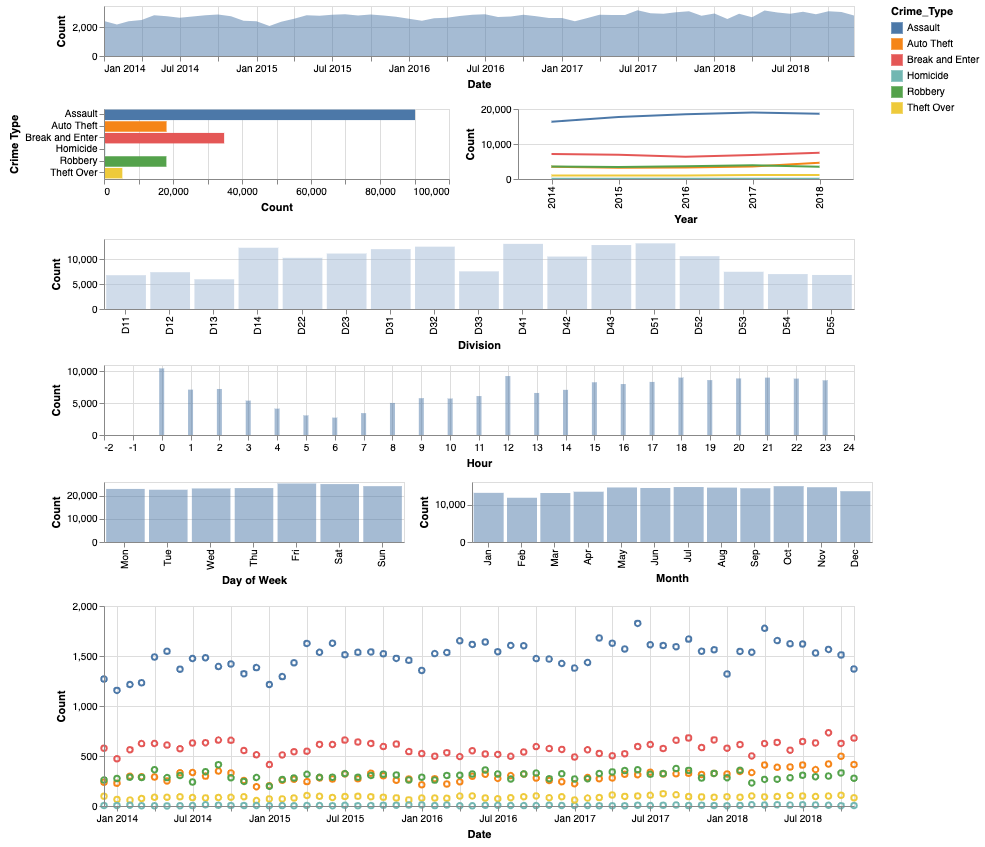

<function __main__.plotCrimes(CrimeType='All')>

In [24]:
upper = display(UpperChart())
ddlCrimeCategory = widgets.Dropdown(options= crimeTypes, description='Crime Type:')
lowerChart = widgets.interact(plotCrimes, CrimeType = crimeTypes)
lowerChart

In [25]:
# homDf =  homicideDf.groupby(['Homicide_Type']).size().reset_index(name='HomCount')
# homiDf = homicideDf.groupby(['Homicide_Type','Division']).size().reset_index(name='HomiCount')
# homselection = alt.selection_multi(fields=['Homicide_Type'])
# color = alt.condition(homselection,
#                       alt.Color('Homicide_Type:N', legend=None),
#                       alt.value('lightgray'))

# hom = alt.Chart(homDf).mark_bar().encode(
#     alt.X('Homicide_Type:N'),
#     alt.Y('HomCount:Q', title = 'Number of Records'),
#     tooltip='HomCount:Q',
#     color=color
# ).add_selection(homselection).properties(width=250)

# homDiv = alt.Chart(homiDf).mark_bar().encode(
#     x=alt.X('Division:N'),
#     y=alt.Y('HomiCount:Q',  title = 'Number of Records'),
#     tooltip='HomiCount:Q'
# ).transform_filter(homselection).properties(width=550)

# alt.hconcat(hom, homDiv)

In [26]:
# dangerousDf = df.groupby('Neighbourhood').size().reset_index(name = 'Count').sort_values('Count', ascending = False).head(15)
# safestDf = df.groupby('Neighbourhood').size().reset_index(name = 'Count').sort_values('Count', ascending = False).tail(15)

### Most Dangerous Neighbourhoods

In [27]:
# from wordcloud import WordCloud, STOPWORDS

# d = {}
# for a, x in dangerousDf.values:
#     d[a] = x
    
# wordcloud = WordCloud(
#     width = 3000,
#     height = 2000,
#     background_color = 'black',
#     stopwords = STOPWORDS)
# wordcloud.generate_from_frequencies(frequencies=d)

# fig = plt.figure(
#     figsize = (40, 30),
#     facecolor = 'k',
#     edgecolor = 'k')
# plt.title('Most Dangerous Neighbourhoods', fontsize=15)
# plt.imshow(wordcloud, interpolation = 'bilinear')
# plt.axis('off')
# plt.tight_layout(pad=0)
# plt.show()

In [28]:
# alt.Chart(dangerousDf).mark_bar().encode(
#     alt.X('Neighbourhood:N'),
#     alt.Y('Count:Q', title = 'Number of Records'),
#     tooltip='Count:Q'
# ).properties(width=750, title = 'Dangerous Neighbourhoods')


In [29]:
# noEducationDf = educationDf.sort_values(['PercentageNotEducated'], ascending = False).head(15)
# alt.Chart(noEducationDf).mark_bar().encode(
#     alt.X('Geography:N'),
#     alt.Y('PercentageNotEducated', title = 'PercentageNotEducated'),
#     tooltip='PercentageNotEducated:Q'
# ).properties(width=750, title= 'Neighbourhoods with low educational attainment')

In [30]:
# incomeBelow5K = incomeDf[incomeDf._id == 987].drop(['_id', 'Category', 'Topic', 'Data Source', 'Characteristic', 'City of Toronto'], axis =1)
# meltDf = pd.melt(incomeBelow5K, var_name="Neighbourhood", value_name="Income")
# meltDf.Income  = meltDf.Income.str.replace(',', '')
# meltDf.Income = meltDf.Income.astype(int)
# meltDf['TotalIncomeMin'] = meltDf.Income.max()
#lowIncomeDf = meltDf.sort_values('Income', ascending= False).head(15)
# data = [go.Bar(
#             x= lowIncomeDf.Neighbourhood,
#             y= lowIncomeDf.Income)]
# layout = go.Layout(
#     title='Neighbourhoods with income <5k',
#     autosize=True,
#     margin=go.layout.Margin(
#         b=150
#     ))
# fig = go.Figure(data=data, layout=layout)
# offline.iplot(fig)

In [31]:
# incomeAbove80k = incomeDf[incomeDf._id == 1012].drop(['_id', 'Category', 'Topic', 'Data Source', 'Characteristic', 'City of Toronto'], axis =1)
# meltDf80K = pd.melt(incomeAbove80k, var_name="Neighbourhood", value_name="Income")
# meltDf80K.Income  = meltDf80K.Income.str.replace(',', '')
# meltDf80K.Income = meltDf80K.Income.astype(int)
# meltDf80K['TotalIncomeMax'] = meltDf80K.Income.max()

# highIncome80Df = meltDf80K.sort_values('Income', ascending = False).head(15)
# data = [go.Bar(
#             x= highIncome80Df.Neighbourhood,
#             y= highIncome80Df.Income)]
# layout = go.Layout(
#     title='Neighbourhoods with income >80k',
#     autosize=True,
#     margin=go.layout.Margin(
#         b=150
#     ))
# fig = go.Figure(data=data, layout=layout)
# offline.iplot(fig)

### Safest Neighbourhoods

In [32]:
# s = {}
# for a, x in safestDf.values:
#     s[a] = x
    
# wordcloud = WordCloud(
#     width = 3000,
#     height = 2000,
#     background_color = 'white',
#     stopwords = STOPWORDS)
# wordcloud.generate_from_frequencies(frequencies=s)

# fig = plt.figure(figsize = (40, 30))
# plt.imshow(wordcloud, interpolation = 'bilinear')
# plt.axis('off')
# plt.tight_layout(pad=0)
# plt.show()